<a href="https://colab.research.google.com/github/2b14-1936179-nyikhantmoe/pokegan/blob/main/pokegan_150.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Names: Nyi Khant Moe (1936179), Denzel Tan Jing Xun (1936377), Andrew He Jing Yan (1935897)
### Class: DIT/FT/2B/14

# Pokemon
#### Let's take a look at what pokemons are there for us to work with

In [ ]:
from torch.utils.data import DataLoader, ConcatDataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as T

In [ ]:
import torch
dtype = torch.cuda.FloatTensor

In [ ]:
IMAGE_DIR = "pokemon"
image_size = 64
batch_size = 8
normalization_stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5) # Convert channels from [0, 1] to [-1, 1]

#### Image Augmentation

In [ ]:
normal_dataset = ImageFolder(IMAGE_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*normalization_stats)]))

# Augment the dataset with mirrored images
mirror_dataset = ImageFolder(IMAGE_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.RandomHorizontalFlip(p=1.0),
    T.ToTensor(),
    T.Normalize(*normalization_stats)]))

# Augment the dataset with color changes
color_jitter_dataset = ImageFolder(IMAGE_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ColorJitter(0.5, 0.5, 0.5),
    T.ToTensor(),
    T.Normalize(*normalization_stats)]))

# Combine the datasets
dataset_list = [normal_dataset, mirror_dataset, color_jitter_dataset]
dataset = ConcatDataset(dataset_list)

dataloader = DataLoader(dataset, batch_size, shuffle=True, num_workers=4, pin_memory=False)

In [ ]:
def denorm(image):
    return image * normalization_stats[1][0] + normalization_stats[0][0]

In [ ]:
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
    
def show_batch(dataloader, nmax=64):
    for images, _ in dataloader:
        show_images(images, nmax)
        break

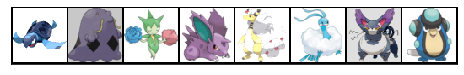

In [ ]:
show_batch(dataloader)

# Discriminator Models
Two discriminator models

In [ ]:
import torch.nn as nn

#### First Model

In [ ]:
disc_64_1 = nn.Sequential(
    # Input is 3 x 64 x 64
    nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(32),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 32 x 32 x 32
    
    nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 64 x 16 x 16
    
    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 128 x 8 x 8
    
    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 256 x 4 x 4
    
    # With a 4x4, we can condense the channels into a 1 x 1 x 1 to produce output
    nn.Conv2d(256, 1, kernel_size=4, stride=1, padding=0, bias=False),
    nn.Flatten(),
    nn.Sigmoid()
)

#### Second Model

In [ ]:
disc_64_2 = nn.Sequential(
    # Input is 3 x 64 x 64
    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 64 x 32 x 32
    
    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 128 x 16 x 16
    
    nn.Conv2d(128, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 128 x 8 x 8
    
    nn.Conv2d(128, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 128 x 4 x 4
    
    # With a 4x4, we can condense the channels into a 1 x 1 x 1 to produce output
    nn.Conv2d(128, 1, kernel_size=4, stride=1, padding=0, bias=False),
    nn.Flatten(),
    nn.Sigmoid()
)

# Generator Models
Two generator models

In [ ]:
seed_size = 16

#### First Model

In [ ]:
gen_64_1 = nn.Sequential(
    # Input seed_size x 1 x 1
    nn.ConvTranspose2d(seed_size, 256, kernel_size=4, padding=0, stride=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # Layer output: 256 x 4 x 4
    
    nn.ConvTranspose2d(256, 128, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # Layer output: 128 x 8 x 8
    
    nn.ConvTranspose2d(128, 64, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # Layer output: 64 x 16 x 16
    
    nn.ConvTranspose2d(64, 32, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(32),
    nn.ReLU(True),
    # Layer output: 32 x 32 x 32
    
    nn.ConvTranspose2d(32, 3, kernel_size=4, padding=1, stride=2, bias=False),
    nn.Tanh()
    # Output: 3 x 64 x 64
)

#### Second Model

In [ ]:
gen_64_2 = nn.Sequential(
    # Input seed_size x 1 x 1
    nn.ConvTranspose2d(seed_size, 128, kernel_size=4, padding=0, stride=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # Layer output: 256 x 4 x 4
    
    nn.ConvTranspose2d(128, 128, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # Layer output: 128 x 8 x 8
    
    nn.ConvTranspose2d(128, 128, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # Layer output: 64 x 16 x 16
    
    nn.ConvTranspose2d(128, 64, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # Layer output: 32 x 32 x 32
    
    nn.ConvTranspose2d(64, 3, kernel_size=4, padding=1, stride=2, bias=False),
    nn.Tanh()
    # Output: 3 x 64 x 64
)

# Model Testing
This is to make sure everything is the correct size

In [ ]:
test_model_size = False

if test_model_size:
    # Make some latent tensors to seed the generator
    seed_batch = torch.randn(batch_size, seed_size, 1, 1, device=device)

    # Get some fake pokemon
    generator=gen_64_1
    to_device(generator, device)
    fake_pokemon = generator(seed_batch)
    print(fake_pokemon.size())

# GPU Setup
Set up GPU for training

In [ ]:
def get_training_device():
    # Use the GPU if possible
    if torch.cuda.is_available():
        return torch.device('cuda')
    # Otherwise use the CPU :-(
    return torch.device('cpu')

def to_device(data, device):
    # This moves the tensors to the device (GPU, CPU)
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dataloader, device):
        self.dataloader = dataloader
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dataloader: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dataloader)

In [ ]:
device = get_training_device()
device

device(type='cuda')

In [ ]:
# Using the dataloader from the top of the notebook, and the selected device
# create a device data loader
dev_dataloader = DeviceDataLoader(dataloader, device)

# Training Functions

## Discriminator

In [ ]:
def train_discriminator(real_pokemon, disc_optimizer):
    # Reset the gradients for the optimizer
    disc_optimizer.zero_grad()
    
    # Train on the real images
    real_predictions = discriminator(real_pokemon)
    # real_targets = torch.zeros(real_pokemon.size(0), 1, device=device) # All of these are real, so the target is 0.
    real_targets = torch.rand(real_pokemon.size(0), 1, device=device) * (0.1 - 0) + 0 # Add some noisy labels to make the discriminator think harder.
    real_loss = F.binary_cross_entropy(real_predictions, real_targets) # Can do binary loss function because it is a binary classifier
    real_score = torch.mean(real_predictions).item() # How well does the discriminator classify the real pokemon? (Higher score is better for the discriminator)
    
    # Make some latent tensors to seed the generator
    latent_batch = torch.randn(batch_size, seed_size, 1, 1, device=device)
    
    # Get some fake pokemon
    fake_pokemon = generator(latent_batch)
    
    # Train on the generator's current efforts to trick the discriminator
    gen_predictions = discriminator(fake_pokemon)
    # gen_targets = torch.ones(fake_pokemon.size(0), 1, device=device)
    gen_targets = torch.rand(fake_pokemon.size(0), 1, device=device) * (1 - 0.9) + 0.9 # Add some noisy labels to make the discriminator think harder.
    gen_loss = F.binary_cross_entropy(gen_predictions, gen_targets)
    gen_score = torch.mean(gen_predictions).item() # How well did the discriminator classify the fake pokemon? (Lower score is better for the discriminator)
    
    # Update the discriminator weights
    total_loss = real_loss + gen_loss
    total_loss.backward()
    disc_optimizer.step()
    return total_loss.item(), real_score, gen_score

## Generator

In [ ]:
def train_generator(gen_optimizer):
    # Clear the generator gradients
    gen_optimizer.zero_grad()
    
    # Generate some fake pokemon
    latent_batch = torch.randn(batch_size, seed_size, 1, 1, device=device)
    fake_pokemon = generator(latent_batch)
    
    # Test against the discriminator
    disc_predictions = discriminator(fake_pokemon)
    targets = torch.zeros(fake_pokemon.size(0), 1, device=device) # We want the discriminator to think these images are real.
    loss = F.binary_cross_entropy(disc_predictions, targets) # How well did the generator do? (How much did the discriminator believe the generator?)
    
    # Update the generator based on how well it fooled the discriminator
    loss.backward()
    gen_optimizer.step()
    
    # Return generator loss
    return loss.item()

# Results viewer
To see the results as we generate the pokemons

In [ ]:
import os
from torchvision.utils import save_image

RESULTS_DIR = 'result-150'
os.makedirs(RESULTS_DIR, exist_ok=True)

In [ ]:
def save_results(index, latent_batch, show=True):
    # Generate fake pokemon
    fake_pokemon = generator(latent_batch)
    
    # Make the filename for the output
    fake_file = "result-image-{0:0=4d}.png".format(index)
    
    # Save the image
    save_image(denorm(fake_pokemon), os.path.join(RESULTS_DIR, fake_file), nrow=8)
    print("Result Saved!")
    
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_pokemon.cpu().detach(), nrow=8).permute(1, 2, 0))

# Full Training

In [ ]:
from tqdm.notebook import tqdm
import torch.nn.functional as F

# Static generation seed batch
fixed_latent_batch = torch.randn(64, seed_size, 1, 1, device=device)

def train(epochs, learning_rate, start_idx=1):
    # Empty the GPU cache to save some memory
    torch.cuda.empty_cache()
    
    # Track losses and scores
    disc_losses = []
    disc_scores = []
    gen_losses = []
    gen_scores = []
    
    # Create the optimizers
    disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.9))
    gen_optimizer = torch.optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.9))
    
    # Run the loop
    for epoch in range(epochs):
        # Go through each image
        for real_img, _ in tqdm(dev_dataloader):
            # Train the discriminator
            disc_loss, real_score, gen_score = train_discriminator(real_img, disc_optimizer)

            # Train the generator
            gen_loss = train_generator(gen_optimizer)
        
        # Collect results
        disc_losses.append(disc_loss)
        disc_scores.append(real_score)
        gen_losses.append(gen_loss)
        gen_scores.append(gen_score)
        
        # Print the losses and scores
        print("Epoch [{}/{}], gen_loss: {:.4f}, disc_loss: {:.4f}, real_score: {:.4f}, gen_score: {:.4f}".format(
            epoch+start_idx, epochs, gen_loss, disc_loss, real_score, gen_score))
        
        # Save the images and show the progress
        save_results(epoch + start_idx, fixed_latent_batch, show=False)
    
    # Return stats
    return disc_losses, disc_scores, gen_losses, gen_scores

In [ ]:
device = get_training_device()
device

device(type='cuda')

In [ ]:
def debug_memory():
    import collections, gc, resource, torch
    print('maxrss = {}'.format(
        resource.getrusage(resource.RUSAGE_SELF).ru_maxrss))
    tensors = collections.Counter((str(o.device), o.dtype, tuple(o.shape))
                                  for o in gc.get_objects()
                                  if torch.is_tensor(o))
    for line in tensors.items():
        print('{}\t{}'.format(*line))

In [ ]:
mem_debug = False
if mem_debug:
    debug_memory()

In [ ]:
# Clean up everything
cleanup = False
if cleanup:
    import gc
    del dev_dataloader
    del discriminator
    del generator
    dev_dataloader = None
    discriminator = None
    generator = None
    gc.collect()
    torch.cuda.empty_cache()

In [ ]:
# Re-initialize the device dataloader
dev_dataloader = DeviceDataLoader(dataloader, device)

# Models Selection
Select models to send to GPU

In [ ]:
# 64 x 64 Discriminators
# discriminator = disc_64_1
discriminator = disc_64_2

# Send to device
discriminator = to_device(discriminator, device)

In [ ]:
# 64 x 64 Generators
# generator = gen_64_1
generator = gen_64_2

# Send to device
generator = to_device(generator, device)

## Training

In [ ]:
# learning_rate = 0.0025 # worked fairly well for disc/gen_64_1
learning_rate = 0.00275
epochs = 150

In [ ]:
history = train(epochs, learning_rate)


Epoch [1/150], gen_loss: 2.6915, disc_loss: 1.2805, real_score: 0.0927, gen_score: 0.4456
Result Saved!



Epoch [2/150], gen_loss: 1.4465, disc_loss: 2.8649, real_score: 0.9408, gen_score: 0.8016
Result Saved!



Epoch [3/150], gen_loss: 0.9853, disc_loss: 0.9881, real_score: 0.4258, gen_score: 0.7145
Result Saved!



Epoch [4/150], gen_loss: 0.8201, disc_loss: 1.6792, real_score: 0.6802, gen_score: 0.5856
Result Saved!



Epoch [5/150], gen_loss: 1.1176, disc_loss: 0.9892, real_score: 0.4468, gen_score: 0.7088
Result Saved!



Epoch [6/150], gen_loss: 0.6497, disc_loss: 1.3722, real_score: 0.3031, gen_score: 0.4156
Result Saved!



Epoch [7/150], gen_loss: 0.6046, disc_loss: 1.7295, real_score: 0.7595, gen_score: 0.7709
Result Saved!



Epoch [8/150], gen_loss: 0.5400, disc_loss: 3.0044, real_score: 0.9245, gen_score: 0.5574
Result Saved!



Epoch [9/150], gen_loss: 2.0766, disc_loss: 0.5663, real_score: 0.0988, gen_score: 0.7246
Result Saved!



Epoch [10/150], gen_loss: 1.0144, disc_loss: 1.2452, real_score: 0.5005, gen_score: 0.5904
Result Saved!



Epoch [11/150], gen_loss: 0.5302, disc_loss: 1.1985, real_score: 0.0475, gen_score: 0.3428
Result Saved!



Epoch [12/150], gen_loss: 1.3862, disc_loss: 1.4761, real_score: 0.1093, gen_score: 0.3469
Result Saved!



Epoch [13/150], gen_loss: 1.3079, disc_loss: 1.4065, real_score: 0.4778, gen_score: 0.5056
Result Saved!



Epoch [14/150], gen_loss: 0.7124, disc_loss: 1.8634, real_score: 0.7949, gen_score: 0.8117
Result Saved!



Epoch [15/150], gen_loss: 1.5322, disc_loss: 0.9343, real_score: 0.3161, gen_score: 0.6346
Result Saved!



Epoch [16/150], gen_loss: 1.9383, disc_loss: 1.2969, real_score: 0.6726, gen_score: 0.9490
Result Saved!



Epoch [17/150], gen_loss: 2.0115, disc_loss: 0.6347, real_score: 0.2890, gen_score: 0.8324
Result Saved!



Epoch [18/150], gen_loss: 3.0382, disc_loss: 0.7503, real_score: 0.1108, gen_score: 0.6693
Result Saved!



Epoch [19/150], gen_loss: 3.0629, disc_loss: 0.4208, real_score: 0.0645, gen_score: 0.8344
Result Saved!



Epoch [20/150], gen_loss: 3.2799, disc_loss: 1.1762, real_score: 0.0039, gen_score: 0.4462
Result Saved!



Epoch [21/150], gen_loss: 3.3586, disc_loss: 0.4102, real_score: 0.0280, gen_score: 0.8559
Result Saved!



Epoch [22/150], gen_loss: 0.8800, disc_loss: 1.8579, real_score: 0.8163, gen_score: 0.7910
Result Saved!



Epoch [23/150], gen_loss: 1.4065, disc_loss: 1.5699, real_score: 0.7520, gen_score: 0.9216
Result Saved!



Epoch [24/150], gen_loss: 1.8168, disc_loss: 0.5777, real_score: 0.2093, gen_score: 0.8138
Result Saved!



Epoch [25/150], gen_loss: 1.2974, disc_loss: 0.8484, real_score: 0.4412, gen_score: 0.8335
Result Saved!



Epoch [26/150], gen_loss: 0.2846, disc_loss: 2.2017, real_score: 0.8380, gen_score: 0.6741
Result Saved!



Epoch [27/150], gen_loss: 3.9726, disc_loss: 1.7999, real_score: 0.8068, gen_score: 0.9691
Result Saved!



Epoch [28/150], gen_loss: 1.4871, disc_loss: 1.4389, real_score: 0.7055, gen_score: 0.9049
Result Saved!



Epoch [29/150], gen_loss: 3.3073, disc_loss: 0.8564, real_score: 0.0179, gen_score: 0.7150
Result Saved!



Epoch [30/150], gen_loss: 3.7643, disc_loss: 0.9636, real_score: 0.0025, gen_score: 0.7104
Result Saved!



Epoch [31/150], gen_loss: 3.4131, disc_loss: 0.5359, real_score: 0.2025, gen_score: 0.8488
Result Saved!



Epoch [32/150], gen_loss: 2.7120, disc_loss: 0.5160, real_score: 0.1829, gen_score: 0.8391
Result Saved!



Epoch [33/150], gen_loss: 3.6093, disc_loss: 0.5425, real_score: 0.0596, gen_score: 0.9824
Result Saved!



Epoch [34/150], gen_loss: 1.2444, disc_loss: 0.9605, real_score: 0.5004, gen_score: 0.8293
Result Saved!



Epoch [35/150], gen_loss: 2.9788, disc_loss: 0.6250, real_score: 0.0051, gen_score: 0.8836
Result Saved!



Epoch [36/150], gen_loss: 4.2649, disc_loss: 0.5954, real_score: 0.0366, gen_score: 0.6235
Result Saved!



Epoch [37/150], gen_loss: 2.5361, disc_loss: 2.9370, real_score: 0.9408, gen_score: 0.8375
Result Saved!



Epoch [38/150], gen_loss: 1.9390, disc_loss: 0.4327, real_score: 0.2032, gen_score: 0.9673
Result Saved!



Epoch [39/150], gen_loss: 3.5683, disc_loss: 0.6779, real_score: 0.0177, gen_score: 0.7718
Result Saved!



Epoch [40/150], gen_loss: 2.2661, disc_loss: 0.4623, real_score: 0.2150, gen_score: 0.9908
Result Saved!



Epoch [41/150], gen_loss: 2.3749, disc_loss: 0.9195, real_score: 0.4773, gen_score: 0.8836
Result Saved!



Epoch [42/150], gen_loss: 1.2949, disc_loss: 0.7408, real_score: 0.2758, gen_score: 0.7690
Result Saved!



Epoch [43/150], gen_loss: 3.2228, disc_loss: 0.4288, real_score: 0.0030, gen_score: 0.7512
Result Saved!



Epoch [44/150], gen_loss: 4.0746, disc_loss: 0.5614, real_score: 0.0014, gen_score: 0.7957
Result Saved!



Epoch [45/150], gen_loss: 1.7052, disc_loss: 1.9288, real_score: 0.8438, gen_score: 0.9429
Result Saved!



Epoch [46/150], gen_loss: 0.9289, disc_loss: 1.9559, real_score: 0.8274, gen_score: 0.8316
Result Saved!



Epoch [47/150], gen_loss: 3.2473, disc_loss: 0.2952, real_score: 0.0357, gen_score: 0.9033
Result Saved!



Epoch [48/150], gen_loss: 0.4618, disc_loss: 0.8174, real_score: 0.4411, gen_score: 0.8763
Result Saved!



Epoch [49/150], gen_loss: 4.2989, disc_loss: 0.6345, real_score: 0.1296, gen_score: 0.7598
Result Saved!



Epoch [50/150], gen_loss: 4.3668, disc_loss: 2.4312, real_score: 0.8932, gen_score: 0.9783
Result Saved!



Epoch [51/150], gen_loss: 2.5224, disc_loss: 2.1957, real_score: 0.8697, gen_score: 0.9869
Result Saved!



Epoch [52/150], gen_loss: 0.9529, disc_loss: 4.4439, real_score: 0.9863, gen_score: 0.9500
Result Saved!



Epoch [53/150], gen_loss: 2.6170, disc_loss: 0.7093, real_score: 0.3718, gen_score: 0.9196
Result Saved!



Epoch [54/150], gen_loss: 1.9163, disc_loss: 1.9481, real_score: 0.8214, gen_score: 0.9799
Result Saved!



Epoch [55/150], gen_loss: 3.5158, disc_loss: 0.6173, real_score: 0.0176, gen_score: 0.8904
Result Saved!



Epoch [56/150], gen_loss: 3.3332, disc_loss: 0.5685, real_score: 0.1997, gen_score: 0.9383
Result Saved!



Epoch [57/150], gen_loss: 1.1731, disc_loss: 1.7531, real_score: 0.6391, gen_score: 0.5719
Result Saved!



Epoch [58/150], gen_loss: 1.3805, disc_loss: 1.9440, real_score: 0.8325, gen_score: 0.8674
Result Saved!



Epoch [59/150], gen_loss: 2.5372, disc_loss: 0.5037, real_score: 0.0359, gen_score: 0.8462
Result Saved!



Epoch [60/150], gen_loss: 1.2393, disc_loss: 1.7352, real_score: 0.8040, gen_score: 0.8914
Result Saved!



Epoch [61/150], gen_loss: 2.2506, disc_loss: 0.8505, real_score: 0.4821, gen_score: 0.9699
Result Saved!



Epoch [62/150], gen_loss: 2.1847, disc_loss: 1.0810, real_score: 0.5411, gen_score: 0.8210
Result Saved!



Epoch [63/150], gen_loss: 1.4802, disc_loss: 0.6979, real_score: 0.3288, gen_score: 0.9717
Result Saved!



Epoch [64/150], gen_loss: 1.3063, disc_loss: 0.4138, real_score: 0.0728, gen_score: 0.8881
Result Saved!



Epoch [65/150], gen_loss: 3.2595, disc_loss: 0.4222, real_score: 0.0289, gen_score: 0.9114
Result Saved!



Epoch [66/150], gen_loss: 3.2044, disc_loss: 0.2903, real_score: 0.0549, gen_score: 0.8831
Result Saved!



Epoch [67/150], gen_loss: 2.4627, disc_loss: 0.5226, real_score: 0.1740, gen_score: 0.9646
Result Saved!



Epoch [68/150], gen_loss: 5.1471, disc_loss: 0.6135, real_score: 0.2105, gen_score: 0.9895
Result Saved!



Epoch [69/150], gen_loss: 4.8556, disc_loss: 0.2373, real_score: 0.0296, gen_score: 0.9612
Result Saved!



Epoch [70/150], gen_loss: 3.7682, disc_loss: 0.4670, real_score: 0.0052, gen_score: 0.9016
Result Saved!



Epoch [71/150], gen_loss: 1.8048, disc_loss: 0.5418, real_score: 0.1846, gen_score: 0.9611
Result Saved!



Epoch [72/150], gen_loss: 1.3176, disc_loss: 1.3717, real_score: 0.7129, gen_score: 0.9563
Result Saved!



Epoch [73/150], gen_loss: 1.4181, disc_loss: 0.5067, real_score: 0.1830, gen_score: 0.8667
Result Saved!



Epoch [74/150], gen_loss: 2.2638, disc_loss: 1.3290, real_score: 0.6579, gen_score: 0.9755
Result Saved!



Epoch [75/150], gen_loss: 2.0505, disc_loss: 0.5604, real_score: 0.2475, gen_score: 0.9525
Result Saved!



Epoch [76/150], gen_loss: 1.6536, disc_loss: 0.7892, real_score: 0.3620, gen_score: 0.7825
Result Saved!



Epoch [77/150], gen_loss: 3.2366, disc_loss: 0.6073, real_score: 0.2555, gen_score: 0.9766
Result Saved!



Epoch [78/150], gen_loss: 2.8855, disc_loss: 1.0608, real_score: 0.5747, gen_score: 0.9426
Result Saved!



Epoch [79/150], gen_loss: 2.2360, disc_loss: 0.7190, real_score: 0.4114, gen_score: 0.9755
Result Saved!



Epoch [80/150], gen_loss: 2.3727, disc_loss: 3.7080, real_score: 0.9712, gen_score: 0.9866
Result Saved!



Epoch [81/150], gen_loss: 3.1765, disc_loss: 0.7471, real_score: 0.3107, gen_score: 0.8511
Result Saved!



Epoch [82/150], gen_loss: 2.1699, disc_loss: 0.7538, real_score: 0.4295, gen_score: 0.9786
Result Saved!



Epoch [83/150], gen_loss: 4.0068, disc_loss: 0.3920, real_score: 0.0301, gen_score: 0.9293
Result Saved!



Epoch [84/150], gen_loss: 2.2664, disc_loss: 0.9275, real_score: 0.3041, gen_score: 0.6228
Result Saved!



Epoch [85/150], gen_loss: 3.0152, disc_loss: 0.5026, real_score: 0.1172, gen_score: 0.9392
Result Saved!



Epoch [86/150], gen_loss: 0.6095, disc_loss: 0.8289, real_score: 0.4036, gen_score: 0.8842
Result Saved!



Epoch [87/150], gen_loss: 5.3683, disc_loss: 0.5151, real_score: 0.0036, gen_score: 0.8506
Result Saved!



Epoch [88/150], gen_loss: 2.5883, disc_loss: 0.7062, real_score: 0.3632, gen_score: 0.9558
Result Saved!



Epoch [89/150], gen_loss: 1.8168, disc_loss: 0.9131, real_score: 0.5097, gen_score: 0.9141
Result Saved!



Epoch [90/150], gen_loss: 3.3130, disc_loss: 0.9163, real_score: 0.4962, gen_score: 0.9544
Result Saved!



Epoch [91/150], gen_loss: 3.4508, disc_loss: 1.0851, real_score: 0.5937, gen_score: 0.9754
Result Saved!



Epoch [92/150], gen_loss: 1.3016, disc_loss: 1.0166, real_score: 0.5522, gen_score: 0.8461
Result Saved!



Epoch [93/150], gen_loss: 1.8552, disc_loss: 2.0270, real_score: 0.8645, gen_score: 0.9532
Result Saved!



Epoch [94/150], gen_loss: 1.6246, disc_loss: 0.8075, real_score: 0.4264, gen_score: 0.9884
Result Saved!



Epoch [95/150], gen_loss: 1.5566, disc_loss: 0.9360, real_score: 0.5039, gen_score: 0.8866
Result Saved!



Epoch [96/150], gen_loss: 3.3594, disc_loss: 0.5589, real_score: 0.0343, gen_score: 0.8837
Result Saved!



Epoch [97/150], gen_loss: 2.8920, disc_loss: 0.6667, real_score: 0.0418, gen_score: 0.7949
Result Saved!



Epoch [98/150], gen_loss: 2.2074, disc_loss: 0.4501, real_score: 0.0508, gen_score: 0.9634
Result Saved!



Epoch [99/150], gen_loss: 3.7994, disc_loss: 0.7469, real_score: 0.0914, gen_score: 0.6791
Result Saved!



Epoch [100/150], gen_loss: 3.8582, disc_loss: 0.6086, real_score: 0.2777, gen_score: 0.9681
Result Saved!



Epoch [101/150], gen_loss: 2.6590, disc_loss: 0.4782, real_score: 0.1182, gen_score: 0.8794
Result Saved!



Epoch [102/150], gen_loss: 1.3549, disc_loss: 1.1024, real_score: 0.5757, gen_score: 0.8423
Result Saved!



Epoch [103/150], gen_loss: 2.7763, disc_loss: 0.5115, real_score: 0.0372, gen_score: 0.7586
Result Saved!



Epoch [104/150], gen_loss: 1.5341, disc_loss: 2.0448, real_score: 0.8532, gen_score: 0.8475
Result Saved!



Epoch [105/150], gen_loss: 2.8805, disc_loss: 0.3698, real_score: 0.0112, gen_score: 0.9536
Result Saved!



Epoch [106/150], gen_loss: 0.9385, disc_loss: 0.3877, real_score: 0.0549, gen_score: 0.9070
Result Saved!



Epoch [107/150], gen_loss: 2.6309, disc_loss: 0.3525, real_score: 0.0311, gen_score: 0.8380
Result Saved!



Epoch [108/150], gen_loss: 2.5165, disc_loss: 0.3297, real_score: 0.0135, gen_score: 0.9797
Result Saved!



Epoch [109/150], gen_loss: 3.0404, disc_loss: 0.4375, real_score: 0.0436, gen_score: 0.8880
Result Saved!



Epoch [110/150], gen_loss: 1.5200, disc_loss: 0.4066, real_score: 0.0277, gen_score: 0.9654
Result Saved!



Epoch [111/150], gen_loss: 3.7094, disc_loss: 0.3371, real_score: 0.0783, gen_score: 0.8735
Result Saved!



Epoch [112/150], gen_loss: 1.4439, disc_loss: 2.4528, real_score: 0.8620, gen_score: 0.6016
Result Saved!



Epoch [113/150], gen_loss: 4.5034, disc_loss: 1.3761, real_score: 0.6749, gen_score: 0.9905
Result Saved!



Epoch [114/150], gen_loss: 2.7824, disc_loss: 0.7124, real_score: 0.0556, gen_score: 0.6769
Result Saved!



Epoch [115/150], gen_loss: 4.2744, disc_loss: 0.3835, real_score: 0.0669, gen_score: 0.9678
Result Saved!



Epoch [116/150], gen_loss: 2.5008, disc_loss: 0.5319, real_score: 0.0356, gen_score: 0.9840
Result Saved!



Epoch [117/150], gen_loss: 3.1622, disc_loss: 0.6829, real_score: 0.0053, gen_score: 0.9399
Result Saved!



Epoch [118/150], gen_loss: 2.9436, disc_loss: 0.6447, real_score: 0.2696, gen_score: 0.8615
Result Saved!



Epoch [119/150], gen_loss: 3.7316, disc_loss: 0.4296, real_score: 0.0027, gen_score: 0.8942
Result Saved!



Epoch [120/150], gen_loss: 2.4384, disc_loss: 0.4117, real_score: 0.1196, gen_score: 0.9844
Result Saved!



Epoch [121/150], gen_loss: 3.2806, disc_loss: 0.3458, real_score: 0.0111, gen_score: 0.8936
Result Saved!



Epoch [122/150], gen_loss: 3.1735, disc_loss: 0.6998, real_score: 0.0055, gen_score: 0.9370
Result Saved!



Epoch [123/150], gen_loss: 3.1622, disc_loss: 0.3790, real_score: 0.0931, gen_score: 0.9659
Result Saved!



Epoch [124/150], gen_loss: 3.3918, disc_loss: 0.3558, real_score: 0.1499, gen_score: 0.9276
Result Saved!



Epoch [125/150], gen_loss: 3.1900, disc_loss: 1.5395, real_score: 0.7592, gen_score: 0.9959
Result Saved!



Epoch [126/150], gen_loss: 1.0381, disc_loss: 2.0647, real_score: 0.8621, gen_score: 0.9100
Result Saved!



Epoch [127/150], gen_loss: 2.6722, disc_loss: 0.3879, real_score: 0.0159, gen_score: 0.9250
Result Saved!



Epoch [128/150], gen_loss: 3.8053, disc_loss: 0.5462, real_score: 0.0095, gen_score: 0.8823
Result Saved!



Epoch [129/150], gen_loss: 2.9768, disc_loss: 0.5155, real_score: 0.0786, gen_score: 0.8238
Result Saved!



Epoch [130/150], gen_loss: 1.4020, disc_loss: 0.8897, real_score: 0.4013, gen_score: 0.8047
Result Saved!



Epoch [131/150], gen_loss: 2.0925, disc_loss: 1.3418, real_score: 0.6890, gen_score: 0.9729
Result Saved!



Epoch [132/150], gen_loss: 4.0892, disc_loss: 0.4699, real_score: 0.0842, gen_score: 0.8871
Result Saved!



Epoch [133/150], gen_loss: 2.9089, disc_loss: 0.5355, real_score: 0.1890, gen_score: 0.9551
Result Saved!



Epoch [134/150], gen_loss: 2.1780, disc_loss: 0.3245, real_score: 0.0103, gen_score: 0.9804
Result Saved!



Epoch [135/150], gen_loss: 2.5708, disc_loss: 0.5752, real_score: 0.1808, gen_score: 0.9891
Result Saved!



Epoch [136/150], gen_loss: 2.1695, disc_loss: 0.6365, real_score: 0.2979, gen_score: 0.9704
Result Saved!



Epoch [137/150], gen_loss: 1.0791, disc_loss: 1.0556, real_score: 0.5842, gen_score: 0.9077
Result Saved!



Epoch [138/150], gen_loss: 3.0142, disc_loss: 0.4334, real_score: 0.0132, gen_score: 0.9730
Result Saved!



Epoch [139/150], gen_loss: 3.0647, disc_loss: 1.0378, real_score: 0.2824, gen_score: 0.5453
Result Saved!



Epoch [140/150], gen_loss: 2.8520, disc_loss: 0.2481, real_score: 0.0186, gen_score: 0.9796
Result Saved!



Epoch [141/150], gen_loss: 2.8470, disc_loss: 0.3141, real_score: 0.0274, gen_score: 0.9429
Result Saved!



Epoch [142/150], gen_loss: 2.0998, disc_loss: 0.3034, real_score: 0.0021, gen_score: 0.9396
Result Saved!



Epoch [143/150], gen_loss: 1.5428, disc_loss: 0.5642, real_score: 0.1184, gen_score: 0.9879
Result Saved!



Epoch [144/150], gen_loss: 4.1902, disc_loss: 0.4537, real_score: 0.0050, gen_score: 0.9373
Result Saved!



Epoch [145/150], gen_loss: 3.0886, disc_loss: 0.2861, real_score: 0.0402, gen_score: 0.9251
Result Saved!



Epoch [146/150], gen_loss: 2.4722, disc_loss: 0.4856, real_score: 0.0209, gen_score: 0.9262
Result Saved!



Epoch [147/150], gen_loss: 0.9198, disc_loss: 2.8549, real_score: 0.9388, gen_score: 0.9384
Result Saved!



Epoch [148/150], gen_loss: 0.8303, disc_loss: 0.9882, real_score: 0.5445, gen_score: 0.8927
Result Saved!



Epoch [149/150], gen_loss: 3.7288, disc_loss: 0.5031, real_score: 0.1858, gen_score: 0.9533
Result Saved!



Epoch [150/150], gen_loss: 2.1750, disc_loss: 0.2560, real_score: 0.0499, gen_score: 0.9237
Result Saved!


# View Results
Here, we will view the results for the GAN using IPython's Image class

In [ ]:
%matplotlib inline
import numpy as np
import PIL

#### Shapes start to form at 50 epochs

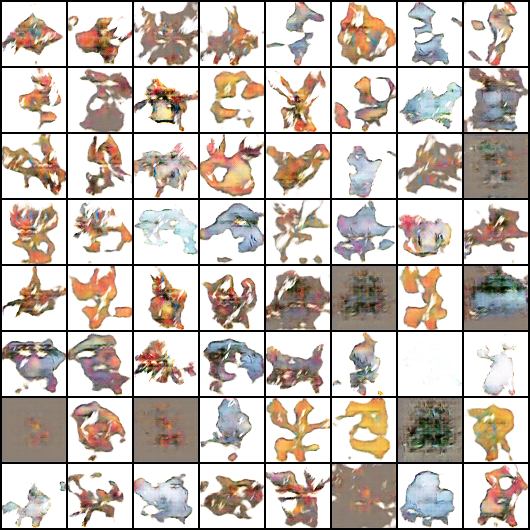

In [ ]:
im=PIL.Image.open('./result-150/result-image-0050.png')
im

#### Distinct pokemons start to form from 100 epochs

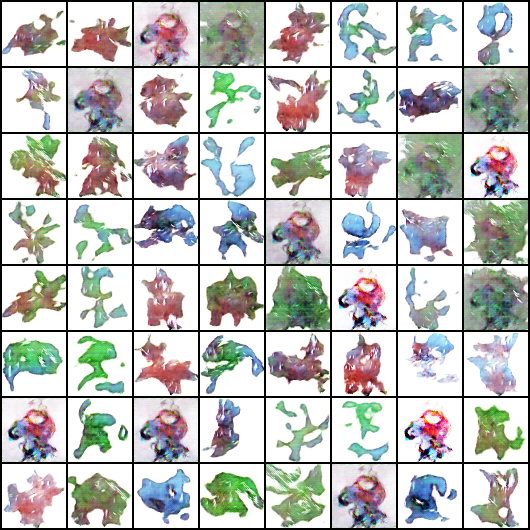

In [ ]:
im=PIL.Image.open('./result-150/result-image-0100.png')
im

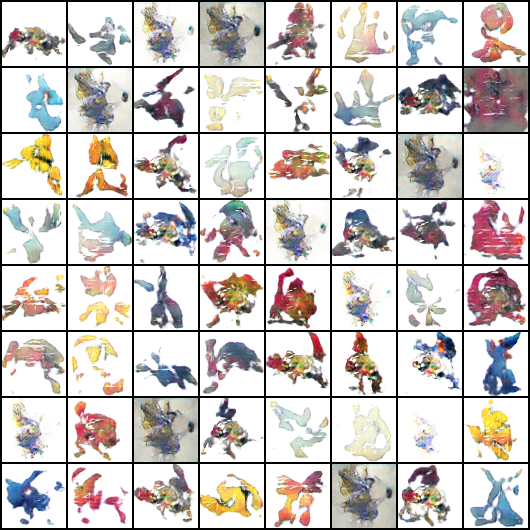

In [ ]:
im=PIL.Image.open('./result-150/result-image-0150.png')
im

# Performance Analysis
This shows losses and scores over time.

In [ ]:
# Extract metrics
disc_losses, disc_scores, gen_losses, gen_scores = history

Text(0.5, 1.0, 'Losses')

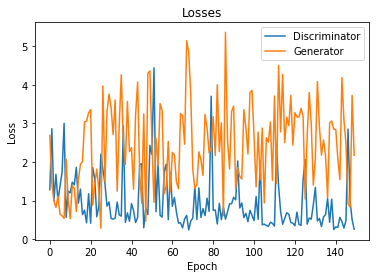

In [ ]:
# Plot generator and discriminator losses
plt.plot(disc_losses, '-')
plt.plot(gen_losses, '-')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses')

#### In general, the losses for both models was relatively good throughout. 
The discriminator was prevented from hitting 0 by the noisy labels, which made it possible for the generator to not lose out over time.

Text(0.5, 1.0, 'Scores')

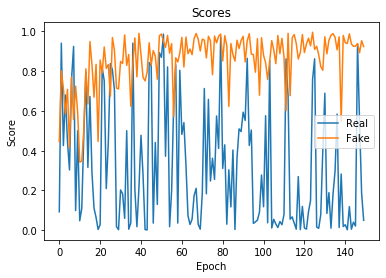

In [ ]:
# Plots scores vs. epochs
plt.plot(disc_scores, '-')
plt.plot(gen_scores, '-')
plt.xlabel('Epoch')
plt.ylabel('Score')
plt.legend(['Real', 'Fake'])
plt.title('Scores')

#### Over time, the discriminator is able to start to tell which Pokemon are real or fake.
The discriminator figured out the generator within 50 epochs.

# Make GIF to show the process of the pokemon generation

In [ ]:
from pathlib import Path
import imageio
image_path = Path('result-150')
images = list(image_path.glob('*.png'))
image_list = []
for file_name in images:
    image_list.append(imageio.imread(file_name))

In [ ]:
imageio.mimwrite('training_images-150.gif', image_list)

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display

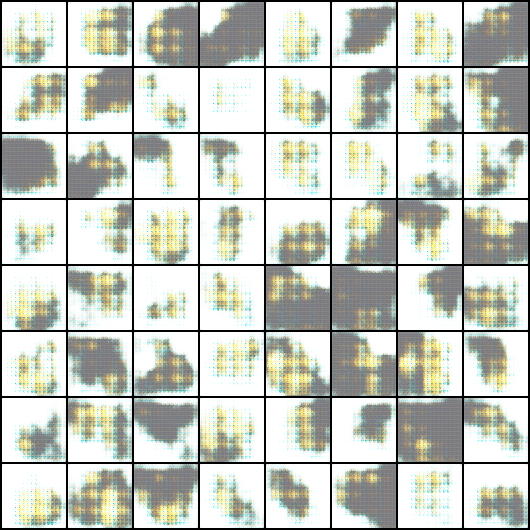

In [ ]:
gifPath = Path("training_images-150.gif") # please paste the whole path from Step 2-6
# Display GIF in Jupyter, CoLab, IPython
with open(gifPath,'rb') as f:
    display.Image(data=f.read(), format='png')

# Thank you :)